<a href="https://colab.research.google.com/github/JPeloquin13/NLP_Portfolio/blob/main/Sim_Cluster_Fed_NLP_TF_USE_8_8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SIADS 699 Capstone - June-Aug 2023 - Team Alpha (Team 11)

This is our secondary approach to our NLP metrics this time using the Tensorflow Universal Sentence Encoder (USE) for transfer learning and extract features.

https://www.tensorflow.org/hub/tutorials/semantic_similarity_with_tf_hub_universal_encoder

In [2]:
#Install Modules

# !pip install fedtools
# !pip install bertopic
# !pip install networkx
# !pip install matplotlib
# !pip install altair


In [6]:
#Load Modules

import pandas as pd
import numpy as np
import re

from FedTools import MonetaryPolicyCommittee
from FedTools import BeigeBooks
from FedTools import FederalReserveMins

# import spacy
# from spacy.lang.en.stop_words import STOP_WORDS
# import en_core_web_lg

# nlp = en_core_web_lg.load()
# from spacy import displacy
# from tqdm import tqdm
# from collections import Counter

from bertopic import BERTopic

from sklearn.feature_extraction.text import CountVectorizer

import tensorflow_hub as hub
import tensorflow as tf
from sklearn.cluster import KMeans

import seaborn as sns
import matplotlib.pyplot as plt


import networkx as nx

import plotly.graph_objects as go

import altair as alt

from collections import defaultdict

from gensim import corpora, models
from gensim.models import Phrases
from gensim.models import CoherenceModel
from gensim.models.ldamodel import LdaModel

#import pyLDAvis
#import pyLDAvis.gensim_models as gensimvis


from matplotlib.lines import Line2D

%matplotlib inline


import nltk
import gensim
import gensim.corpora as corpora


from sentence_transformers import SentenceTransformer
from umap import UMAP
from hdbscan import HDBSCAN
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

from bertopic.vectorizers import ClassTfidfTransformer
from gensim.models.coherencemodel import CoherenceModel


import re, nltk, spacy, gensim
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from pprint import pprint
#import pyLDAvis
import matplotlib.pyplot as plt
%matplotlib inline

import spacy

spacy.cli.download("en_core_web_lg")
nlp = spacy.load("en_core_web_lg")
from spacy.lang.en.stop_words import STOP_WORDS


✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')


In [15]:
# nltk.download('wordnet')
# nltk.download('omw-1.4')
# nltk.download('punkt')

In [14]:
# Dependencies for requirements file

!python -V
print("Pandas:", pd.__version__)
print("Numpy:", np.__version__)
#print("Matplotlib:", matplotlib.__version__)
print("Seaborn:", sns.__version__)
print("FedTools:", "0.07")
print("NLTK:", nltk.__version__)
print("Gensim:", gensim.__version__)
#print("pyLDAvis:", pyLDAvis.__version__)
#print("sklearn:", sklearn.__version__)
#print("top2vec:", top2vec.__version__)
#print("bertopic:", bertopic.__version__)
#print("umap:", umap.__version__)
print("spaCy:", spacy.__version__)
print("re:", re.__version__)

Python 3.10.12
Pandas: 1.5.3
Numpy: 1.23.5
Seaborn: 0.12.2
FedTools: 0.07
NLTK: 3.8.1
Gensim: 4.3.1
spaCy: 3.5.4
re: 2.2.1


# Part 1a:  Retrieve FOMC Minutes

In [16]:
# Set parameters for download



fed_mins = FederalReserveMins(
            main_url = 'https://www.federalreserve.gov',
            calendar_url ='https://www.federalreserve.gov/monetarypolicy/fomccalendars.htm',
            start_year = 2008,
            historical_split = 2017,
            verbose = True,
            thread_num = 10)

mins_dataset = fed_mins.find_minutes()

Constructing links between 2008 and 2023
Extracting Federal Reserve Minutes.
Retrieving articles.
...........................................................................................................................

In [17]:
# Save DataFrame to CSV file
mins_dataset.to_csv('mins_dataset.csv', index=False)

#Read in Monetary Policy into df

df = pd.read_csv('mins_dataset.csv')
df.shape

(123, 1)

In [18]:
df[0:]

,Federal_Reserve_Mins
0,"January 29-30, 2008 Present:Mr. Bernanke, Cha..."
1,"March 18, 2008 Present:Mr. Bernanke, Chairman..."
2,"April 29-30, 2008 PRESENT:Mr. Bernanke, Chair..."
3,"August 5, 2008 PRESENT: Mr. Bernanke, Chairma..."
4,"September 16, 2008 PRESENT:Mr. Bernanke, Chai..."
...,...
118,"The Federal Reserve, the central bank of the U..."
119,"The Federal Reserve, the central bank of the U..."
120,"The Federal Reserve, the central bank of the U..."
121,"The Federal Reserve, the central bank of the U..."


In [19]:
df.rename(columns={"Federal_Reserve_Mins": "mins"}, inplace=True)
df.head()

,mins
0,"January 29-30, 2008 Present:Mr. Bernanke, Cha..."
1,"March 18, 2008 Present:Mr. Bernanke, Chairman..."
2,"April 29-30, 2008 PRESENT:Mr. Bernanke, Chair..."
3,"August 5, 2008 PRESENT: Mr. Bernanke, Chairma..."
4,"September 16, 2008 PRESENT:Mr. Bernanke, Chai..."


 We load the Universal Sentence Encoder to transform text data into numerical vectors and then applies KMeans clustering to group similar documents together based on their vector representations. The cluster labels are then added back to the original DataFrame for further analysis or visualization.

In [20]:

# Load the Universal Sentence Encoder model
embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")



documents = df['mins'].tolist()

# Preprocess and encode the documents using Universal Sentence Encoder
embedded_docs = embed(documents)

# Convert the embeddings to a numpy array
embedded_docs_np = np.array(embedded_docs)

# Perform clustering using KMeans
num_clusters = 5  # run elbow method and 4-5 clusters
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(embedded_docs_np)

# Add cluster labels back to the DataFrame
df['cluster_label'] = cluster_labels


In [21]:
df.head()

,mins,cluster_label
0,"January 29-30, 2008 Present:Mr. Bernanke, Cha...",0
1,"March 18, 2008 Present:Mr. Bernanke, Chairman...",2
2,"April 29-30, 2008 PRESENT:Mr. Bernanke, Chair...",2
3,"August 5, 2008 PRESENT: Mr. Bernanke, Chairma...",2
4,"September 16, 2008 PRESENT:Mr. Bernanke, Chai...",2


We then calculate the cosine similarity between consecutive rows of sentence embeddings generated by the Universal Sentence Encoder (USE) model and then adds the similarity scores as a new column to the DataFrame.

In [22]:
# Function to calculate similarity between two vectors

def cosine_similarity(u, v):
    return np.dot(u, v) / (np.linalg.norm(u) * np.linalg.norm(v))

# Preprocess sentences and encode them into fixed-length vectors
sentence_embeddings = embed(df['mins'])

# Calculate similarity score between consecutive rows
similarity_scores = []
for i in range(len(sentence_embeddings) - 1):
    similarity_score = cosine_similarity(sentence_embeddings[i], sentence_embeddings[i + 1])
    similarity_scores.append(similarity_score)

# Add the similarity scores as a new column in the DataFrame
df['similarity_score'] = [np.nan] + similarity_scores

df.head()

,mins,cluster_label,similarity_score
0,"January 29-30, 2008 Present:Mr. Bernanke, Cha...",0,NaN
1,"March 18, 2008 Present:Mr. Bernanke, Chairman...",2,0.915566
2,"April 29-30, 2008 PRESENT:Mr. Bernanke, Chair...",2,0.958913
3,"August 5, 2008 PRESENT: Mr. Bernanke, Chairma...",2,0.933642
4,"September 16, 2008 PRESENT:Mr. Bernanke, Chai...",2,0.957738


In [ ]:
# # Save DataFrame to json

# df.to_json('df_final.json', orient='records')


In [24]:

# Group by 'cluster_label' and aggregate 'mins' as a list and 'similarity_score' as the mean

grouped_df = df.groupby('cluster_label').agg({
    'mins': lambda x: x.tolist(),             # Combine 'mins' values into a list
    'similarity_score': 'mean'               # Calculate the mean of 'similarity_score'
}).reset_index()                             # Reset the index for the resulting DataFrame

# Display the first 20 rows of the grouped and aggregated DataFrame
grouped_df.head(20)


,cluster_label,mins,similarity_score
0,0,"[January 29-30, 2008 Present:Mr. Bernanke, Ch...",0.884629
1,1,"[The Federal Reserve, the central bank of the ...",0.948379
2,2,"[March 18, 2008 Present:Mr. Bernanke, Chairma...",0.938490
3,3,"[November 1-2, 2011 PRESENT: Ben Berna...",0.939296
4,4,"[The Federal Reserve, the central bank of the ...",0.937707


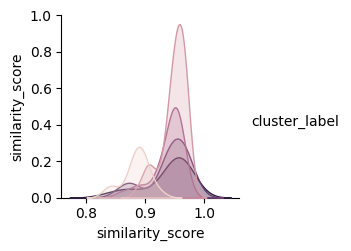

In [25]:
%matplotlib inline

# Pair plot to visualize relationships

sns.pairplot(df, hue='cluster_label', diag_kind='kde')
plt.show()


Here we create a graph visualization using Plotly to depict relationships among documents and their cluster memberships. We construct a NetworkX graph, add nodes for documents and clusters, create edges within clusters and between documents and clusters, position nodes using a layout algorithm, and then generate an interactive Plotly graph where nodes represent documents and clusters, and edges depict relationships and similarities among them.

In [26]:
docs_column = 'mins'
clusters_column = 'cluster_label'


# Create a dictionary where the keys are the cluster IDs and the values are lists of documents in each cluster.
clusters_dict = df.groupby(clusters_column)[docs_column].apply(list).to_dict()

# Create an empty graph
G = nx.Graph()


# Add nodes to the graph for each document and each cluster
for doc in df[docs_column]:
    G.add_node(doc)

for cluster in df[clusters_column].unique():
    G.add_node(cluster)

# Add edges between nodes in the same cluster
for cluster_docs in clusters_dict.values():
    for i in range(len(cluster_docs)):
        for j in range(i + 1, len(cluster_docs)):
            G.add_edge(cluster_docs[i], cluster_docs[j])

# Add edges from each document to each cluster it belongs to
for doc, cluster in zip(df[docs_column], df[clusters_column]):
    G.add_edge(doc, cluster)

# Convert the NetworkX graph to a Plotly graph
pos = nx.spring_layout(G)  # You can choose a different layout if you prefer.
edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.append(x0)
    edge_x.append(x1)
    edge_x.append(None)
    edge_y.append(y0)
    edge_y.append(y1)
    edge_y.append(None)

edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    hoverinfo='none',
    mode='lines')

node_x = []
node_y = []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)

# Set the marker size for cluster nodes to make them larger
node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers',
    hoverinfo='text',
    marker=dict(
        size=[40 if node in df[clusters_column].values else 20 for node in G.nodes()],
        showscale=True,
        colorscale='YlGnBu',
        colorbar=dict(
            thickness=15,
            title='Node Connections',
            xanchor='left',
            titleside='right'
        )
    )
)

# Customize node labels to show only cluster names
node_text = [node if node in df[clusters_column].values else '' for node in G.nodes()]
node_trace.text = node_text

# Create the Plotly graph and combine edge and node traces
fig = go.Figure(data=[edge_trace, node_trace],
                layout=go.Layout(
                    title='Cluster Network Visualization Of Fed Mins',
                    showlegend=False,
                    hovermode='closest',
                    margin=dict(b=0, l=0, r=0, t=0),
                    xaxis=dict(showgrid=False, zeroline=False, title='Cluster Ids'),
                    yaxis=dict(showgrid=False, zeroline=False, title='Number of Connections')
                ))

# Add main title to the chart
fig.update_layout(title_text="Cluster Network Visualization Of Fed Mins")


fig.show(renderer="colab")


Below, we have an Altair scatter plot that visualizes the relationship between similarity scores and documents.

In [ ]:


# Enable Altair renderer for Jupyter Notebook
#alt.renderers.enable('notebook')

# Create a scatter plot with Altair

scatter_plot = alt.Chart(df).mark_circle(size=60).encode(
    x='similarity_score:Q',
    y=alt.Y('mins:N', axis=alt.Axis(labels=False)),
    #y=alt.Y('mins:N', axis=alt.Axis(labelExpr="datum.value.slice(0, 12) + '...'")),
    color='cluster_label:N',
    tooltip=['mins', 'cluster_label', 'similarity_score']
).properties(
    title='Cluster Similarity Scores vs. Minutes with Cluster Labels',
    width=500,
    height=300
)

# Remove x-axis ticks
scatter_plot = scatter_plot.configure_axisY(ticks=False)


# Display the plot using IPython display
display(scatter_plot)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



alt.Chart(...)

Below, heat lane visualization displaying the top 10 documents in each of the top 3 clusters based on similarity scores.

In [28]:
#Heat lane visualisation of top 3 clusters with top 10 docs each

from IPython.display import display

# Filter and sort the DataFrame to get the top 10 documents in each cluster

top_clusters = df.groupby('cluster_label').apply(lambda x: x.nlargest(10, 'similarity_score')).reset_index(drop=True)

# Filter to keep only the top 3 clusters

top_3_clusters = top_clusters.groupby('cluster_label').apply(lambda x: x.nlargest(10, 'similarity_score')).reset_index(drop=True)

# Pivot the DataFrame to have cluster labels as columns and similarity scores as values

pivoted_df = top_3_clusters.pivot(index='mins', columns='cluster_label', values='similarity_score').reset_index()

# Melt the DataFrame to prepare for heatmap visualization

melted_df = pd.melt(pivoted_df, id_vars='mins', var_name='cluster_label', value_name='similarity_score')

# Create the heat lane visualization with Altair

heat_lane_plot = alt.Chart(melted_df).mark_rect().encode(
    alt.X('cluster_label:N', axis=alt.Axis(title='Cluster Label')),
    alt.Y('mins:N', axis=alt.Axis(title='Documents', labels=False), sort=alt.EncodingSortField(field='similarity_score', op='sum', order='descending')),
    alt.Color('similarity_score:Q', scale=alt.Scale(scheme='viridis'), legend=alt.Legend(title='Similarity Score'))
).properties(
    title='Heat Lane - Cluster Similarity Scores -  Top Three Clusters with top 10 Fed Mins',
    width=500,
    height=300
)

# Show the heat lane plot

display (heat_lane_plot)







alt.Chart(...)

Below, scatter plot to visually identify clusters and their relationships in the original space without dimension reduction.

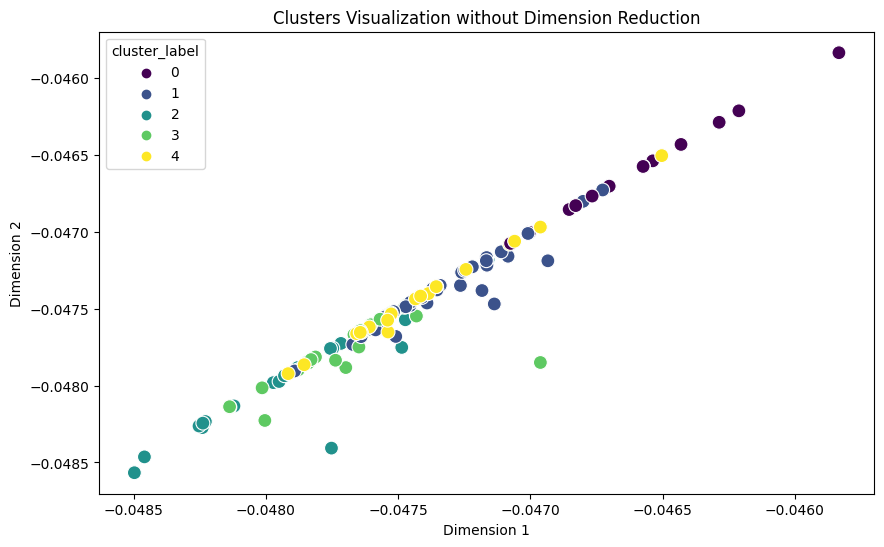

In [29]:
%matplotlib inline

# Create a scatter plot using Seaborn without dimension reduction
plt.figure(figsize=(10, 6))
sns.scatterplot(x=embedded_docs_np[:, 0], y=embedded_docs_np[:, 1], hue=df['cluster_label'], palette='viridis', s=100)
plt.title('Clusters Visualization without Dimension Reduction')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.show()

Below, dimensionality reduction using t-Distributed Stochastic Neighbor Embedding (t-SNE) to reduce the dimensionality of the embedded document vectors from the Universal Sentence Encoder to 3D space.

In [30]:
from sklearn.manifold import TSNE
import plotly.express as px

# Reduce dimensions using t-SNE to 3D
tsne = TSNE(n_components=3, random_state=42)
reduced_docs = tsne.fit_transform(embedded_docs_np)

# Create a DataFrame with the 3D t-SNE representation and cluster labels
tsne_df = pd.DataFrame(reduced_docs, columns=['tsne_dim1', 'tsne_dim2', 'tsne_dim3'])
tsne_df['cluster_label'] = cluster_labels

# Get the size of each cluster (number of data points in each cluster)
cluster_sizes = df['cluster_label'].value_counts().sort_index().tolist()

# Create a 3D scatter plot using Plotly
fig = px.scatter_3d(tsne_df, x='tsne_dim1', y='tsne_dim2', z='tsne_dim3',
                    color='cluster_label', size='cluster_label', size_max=10,
                    opacity=0.7, symbol='cluster_label', color_continuous_scale='Viridis',
                    title='Clusters Visualization with Plotly and t-SNE')

fig.show(renderer="colab")

Below, we visualize the original embedded document vectors along with their cluster labels without dimension reduction

In [31]:
# Create a DataFrame with the original embeddings and cluster labels
embeddings_df = pd.DataFrame(embedded_docs_np, columns=[f'feature_{i}' for i in range(embedded_docs_np.shape[1])])
embeddings_df['cluster_label'] = cluster_labels

# Create a 3D scatter plot using Plotly
fig = px.scatter_3d(embeddings_df, x='feature_0', y='feature_1', z='feature_2',
                    color='cluster_label', opacity=0.7, symbol='cluster_label',
                    color_continuous_scale='Viridis', title='Clusters Visualization without Dimension Reduction')

fig.show(renderer="colab")

### 2. Bertopic Approach to NLP Analysis - Topic Modeling ###

Here, we load the Universal Sentence Encoder (USE) model from TensorFlow Hub and apply it to our data using the BERTopic library to perform topic modeling.

In [32]:
#Universal Sentence Encoder (USE)

use_data = df['mins'].to_list()

embedding_model = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")
usetopic_mdl = BERTopic(verbose=True, embedding_model=embedding_model).fit(use_data)

usetopic_mdl.get_topic_info().head(5)

  0%|          | 0/123 [00:00<?, ?it/s]WARNING:tensorflow:From /usr/local/lib/python3.10/dist-packages/bertopic/backend/_use.py:54: _EagerTensorBase.cpu (from tensorflow.python.framework.ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.identity with explicit device placement instead.
100%|██████████| 123/123 [00:05<00:00, 22.65it/s]
2023-08-11 14:25:35,207 - BERTopic - Transformed documents to Embeddings
2023-08-11 14:25:45,009 - BERTopic - Reduced dimensionality
2023-08-11 14:25:45,059 - BERTopic - Clustered reduced embeddings


,Topic,Count,Name,Representation,Representative_Docs
0,0,97,0_the_of_in_and,"[the, of, in, and, to, that, for, on, inflatio...","[The Federal Reserve, the central bank of the ..."
1,1,15,1_the_of_in_to,"[the, of, in, to, and, that, for, committee, w...","[The Federal Reserve, the central bank of the ..."
2,2,11,2_the_of_and_to,"[the, of, and, to, in, that, inflation, partic...","[The Federal Reserve, the central bank of the ..."


In [33]:
#see the top 10 most frequent topics that have been generated:

usetopic_mdl.get_topic_info()[1:11]

,Topic,Count,Name,Representation,Representative_Docs
1,1,15,1_the_of_in_to,"[the, of, in, to, and, that, for, committee, w...","[The Federal Reserve, the central bank of the ..."
2,2,11,2_the_of_and_to,"[the, of, and, to, in, that, inflation, partic...","[The Federal Reserve, the central bank of the ..."


perform topic modeling and clustering on text data by integrating scikit-learn's CountVectorizer and KMeans with the BERTopic library

In [36]:
#clustering

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.cluster import KMeans

vectorizer_model=CountVectorizer(stop_words="english", min_df=10)

cluster_model = KMeans(n_clusters=30)
cls_topic_model = BERTopic(vectorizer_model = vectorizer_model, hdbscan_model=cluster_model).fit(use_data)

cls_topic_model.get_topic_info().head(5)

# Extract topic information
topic_info = cls_topic_model.get_topic_info()

# Concatenate topic information to the original DataFrame
df_with_topics = pd.concat([df, pd.DataFrame(topic_info)], axis=1)

# Display the updated DataFrame
df_with_topics.head()


2023-08-11 14:38:20,822 - BERTopic - Transformed documents to Embeddings
2023-08-11 14:38:23,408 - BERTopic - Reduced dimensionality
2023-08-11 14:38:23,515 - BERTopic - Clustered reduced embeddings


,mins,cluster_label,similarity_score,Topic,Count,Name,Representation,Representative_Docs
0,"January 29-30, 2008 Present:Mr. Bernanke, Cha...",0,NaN,0.0,8.0,0_economic_inflation_prices_participants,"[economic, inflation, prices, participants, co...","[June 21-22, 2011 PRESENT: Ben Bernank..."
1,"March 18, 2008 Present:Mr. Bernanke, Chairman...",2,0.915566,1.0,7.0,1_markets_prices_growth_financial,"[markets, prices, growth, financial, federal, ...","[March 18, 2008 Present:Mr. Bernanke, Chairma..."
2,"April 29-30, 2008 PRESENT:Mr. Bernanke, Chair...",2,0.958913,2.0,7.0,2_participants_economic_market_federal,"[participants, economic, market, federal, busi...","[The Federal Reserve, the central bank of the ..."
3,"August 5, 2008 PRESENT: Mr. Bernanke, Chairma...",2,0.933642,3.0,7.0,3_participants_inflation_rate_federal,"[participants, inflation, rate, federal, polic...","[The Federal Reserve, the central bank of the ..."
4,"September 16, 2008 PRESENT:Mr. Bernanke, Chai...",2,0.957738,4.0,6.0,4_economic_policy_participants_period,"[economic, policy, participants, period, finan...","[The Federal Reserve, the central bank of the ..."


In [37]:
#see the top 10 most frequent topics that have been generated:

cls_topic_model.get_topic_info()[1:11]

,Topic,Count,Name,Representation,Representative_Docs
1,1,7,1_markets_prices_growth_financial,"[markets, prices, growth, financial, federal, ...","[March 18, 2008 Present:Mr. Bernanke, Chairma..."
2,2,7,2_participants_economic_market_federal,"[participants, economic, market, federal, busi...","[The Federal Reserve, the central bank of the ..."
3,3,7,3_participants_inflation_rate_federal,"[participants, inflation, rate, federal, polic...","[The Federal Reserve, the central bank of the ..."
4,4,6,4_economic_policy_participants_period,"[economic, policy, participants, period, finan...","[The Federal Reserve, the central bank of the ..."
5,5,6,5_inflation_percent_rate_federal,"[inflation, percent, rate, federal, market, 20...","[The Federal Reserve, the central bank of the ..."
6,6,6,6_inflation_board_participants_policy,"[inflation, board, participants, policy, divis...","[The Federal Reserve, the central bank of the ..."
7,7,5,7_purchases_committee_policy_asset,"[purchases, committee, policy, asset, federal,...","[The Federal Reserve, the central bank of the ..."
8,8,5,8_inflation_rate_committees_market,"[inflation, rate, committees, market, particip...","[The Federal Reserve, the central bank of the ..."
9,9,5,9_mr_federal_credit_purchases,"[mr, federal, credit, purchases, debt, markets...","[August 11-12, 2009 PRESENT:Mr. Bernanke, Cha..."
10,10,5,10_inflation_market_rate_economic,"[inflation, market, rate, economic, committee,...","[The Federal Reserve, the central bank of the ..."


### 3. Custom Topic Modeling Approach ###

Here we try a new approach.  A custom processe on our documents by tokenizing, removing stop words, filtering out infrequent words, adding bigrams, and creating a dictionary and a corpus.


In [38]:
docs = df['mins'].to_list()

stoplist = ['the', 'a', 'an', 'of', 'and', 'or', 'in', 'for', 'to', 'at', 'by', 'from', 'with', 'on', 'as', 'but', 'is', 'are', 'was', 'were', 'be', 'been', 'am', 'i', 'me', 'my', 'we', 'our', 'you', 'fish', 'troll', 'ha', 'bye', 'ok', 'okay', 'andy', 'idiot']

# remove common words and tokenize
texts = [[word for word in document.split() if word not in stoplist]
         for document in docs]

# remove words that appear only once
frequency = defaultdict(int)
for text in texts:
    for token in text:
        frequency[token] += 1

texts = [[token for token in text if frequency[token] > 1]
         for text in texts]


# Add bigrams to docs (only ones that appear 20 times or more).
bigram = Phrases(texts, min_count=20)
for idx in range(len(texts)):
    for token in bigram[texts[idx]]:
        if '_' in token:
            # Token is a bigram, add to document.
            texts[idx].append(token)

# Create the dictionary
dictionary = corpora.Dictionary(texts)

# Filter out words that occur less than X documents,
# or more than X% of the documents.
dictionary.filter_extremes(no_below=50, no_above=0.5)

# Create the corpus.  This is a Term Frequency
# or Bag of Words representation.
corpus = [dictionary.doc2bow(text) for text in texts]

print(f'Number of unique tokens: {len(dictionary)}')
print(f'Number of documents: {len(corpus)}')





Number of unique tokens: 508
Number of documents: 123


We create an LDA model using the Gensim library for topic modeling. It uses the specified parameters and training data to discover the specified number of topics from the given corpus of documents.

In [39]:


# Define the number of topics
NUM_TOPICS = 10

# Define parameters for the LDA model
chunksize = 2000           # Number of documents to be used in each training chunk
passes = 6                 # Number of complete passes through the dataset
iterations = 100           # Maximum number of iterations for each document
eval_every = 1             # Frequency of calculating and updating model perplexity
temp = dictionary[0]       # A placeholder variable for the dictionary's first token
id2word = dictionary.id2token  # Mapping of token IDs to words in the dictionary

# Create an LDA model
model = LdaModel(
    corpus=corpus,          # The bag-of-words corpus of documents
    id2word=id2word,        # Mapping of token IDs to words
    chunksize=chunksize,    # Number of documents in each training chunk
    alpha='auto',           # Parameter for topic distribution (set to 'auto')
    eta='auto',             # Parameter for word distribution (set to 'auto')
    iterations=iterations,  # Maximum number of iterations for each document
    num_topics=NUM_TOPICS,  # Number of topics to discover
    passes=passes,          # Number of complete passes through the dataset
    eval_every=eval_every   # Frequency of calculating perplexity
)


This function is used to compute coherence values for different numbers of topics using LDA models. It helps in determining the optimal number of topics for topic modeling based on the coherence measure specified.

In [40]:

from gensim.models.ldamodel import LdaModel
from gensim.models.coherencemodel import CoherenceModel

def compute_coherence_values(dictionary, corpus, texts, cohere, limit, start=2, step=2):
    """
    Compute coherence values for different numbers of topics using LDA.

    :param dictionary: Gensim dictionary
    :param corpus: Gensim corpus
    :param texts: List of tokenized texts
    :param cohere: Coherence measure ('c_v', 'u_mass', etc.)
    :param limit: Maximum number of topics to evaluate
    :param start: Starting number of topics
    :param step: Step size for the number of topics
    :return: List of coherence values
    """

    coherence_values = []

    for num_topics in range(start, limit, step):
        model = LdaModel(corpus=corpus,
                         id2word=dictionary,
                         num_topics=num_topics,
                         chunksize=chunksize,
                         alpha='auto',
                         eta='auto',
                         iterations=iterations,
                         passes=passes,
                         eval_every=eval_every,
                         random_state=42)
        coherencemodel = CoherenceModel(model=model,
                                        texts=texts,
                                        dictionary=dictionary,
                                        coherence=cohere)
        coherence_values.append(coherencemodel.get_coherence())

    return coherence_values


We calculate coherence values for different numbers of topics using the specified coherence measure ('c_v')

In [41]:

limit = 50
start = 2
step = 2

coherence_values = compute_coherence_values(
    dictionary=dictionary,
    corpus=corpus,
    texts=texts,
    cohere='c_v',
    start=start,
    limit=limit,
    step=step
)


We then generate a line plot that visually depicts the coherence scores for different numbers of topics in an LDA model. It highlights the optimal number of topics and provides a legend to explain the plot elements.

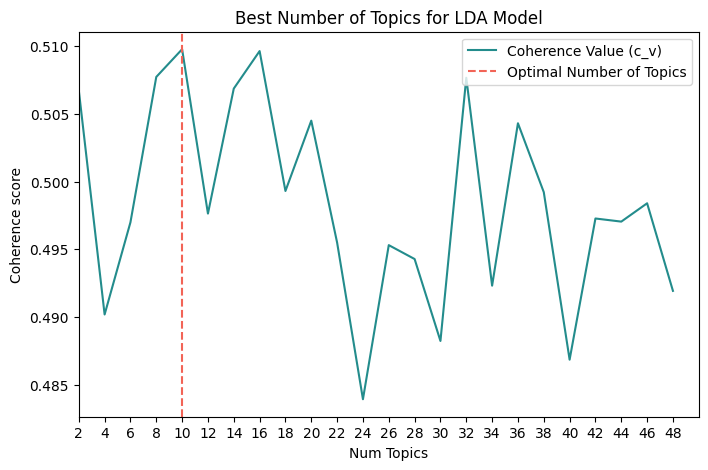

In [42]:
%matplotlib inline

plt.figure(figsize=(8,5))

# Create a custom x-axis
x = range(start, limit, step)

# Build the line plot
ax = sns.lineplot(x=x, y=coherence_values, color='#238C8C')

# Set titles and labels
plt.title("Best Number of Topics for LDA Model")
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.xlim(start, limit)
plt.xticks(range(2, limit, step))

# Add a vertical line to show the optimum number of topics
plt.axvline(x[np.argmax(coherence_values)],
            color='#F26457', linestyle='--')

# Draw a custom legend
legend_elements = [Line2D([0], [0], color='#238C8C',
                          ls='-', label='Coherence Value (c_v)'),
                   Line2D([0], [1], color='#F26457',
                          ls='--', label='Optimal Number of Topics')]

ax.legend(handles=legend_elements, loc='upper right')

### 4. Another Bertopic Approach ###

This approach uses bertopic to perform various text preprocessing, embedding extraction, dimensionality reduction, clustering, and topic modeling.

In [43]:
filtered_text = []
lemmatizer = WordNetLemmatizer()

for w in df['mins']:
  filtered_text.append(lemmatizer.lemmatize(w))
print(filtered_text[:1])


df['mins'] = df['mins'].str.replace('[^\w\s]', '').str.lower()

#  Extract embeddings
embedding_mdl = SentenceTransformer("all-MiniLM-L6-v2")

# Reduce dimensionality
umap_mdl = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine')

# Cluster reduced embeddings
hdbscan_mdl = HDBSCAN(min_cluster_size=15, metric='euclidean') #, cluster_selection_method='eom', prediction_data=True)

# Create topic representation
ctfidf_mdl = ClassTfidfTransformer()

topic_model = BERTopic(
  embedding_model=embedding_mdl,    # Extract embeddings
  umap_model=umap_mdl,              # Reduce dimensionality
  hdbscan_model=hdbscan_mdl,        #  Cluster reduced embeddings
  #vectorizer_model=vectorizer_model,  #  Tokenize topics
  ctfidf_model=ctfidf_mdl,          # Extract topic words

  nr_topics=10
)

bert_data = df['mins'].to_list()
topics, probabilities = topic_model.fit_transform(bert_data)
topic_model.get_topic_info().head(5)



['January 29-30, 2008  Present:Mr. Bernanke, ChairmanMr. Geithner, Vice ChairmanMr. FisherMr. KohnMr. KrosznerMr. MishkinMs. PianaltoMr. PlosserMr. SternMr. Warsh  Messrs. Evans, Lacker, and Lockhart, and Ms. Yellen, Alternate Members of the Federal Open Market Committee  Messrs. Hoenig, Poole, and Rosengren, Presidents of the Federal Reserve Banks of Kansas City, St. Louis, and Boston, respectively  Mr. Madigan, Secretary and EconomistMs. Danker, Deputy SecretaryMr. Skidmore, Assistant SecretaryMs. Smith, Assistant SecretaryMr. Alvarez, General CounselMr. Baxter, Deputy General CounselMr. Sheets, EconomistMr. Stockton, Economist  Messrs. Connors, English, and Kamin, Ms. Mester, Messrs. Rosenblum, Slifman, Sniderman, Tracy, and Wilcox, Associate Economists  Mr. Dudley, Manager, System Open Market Account  Mr. Struckmeyer,1 Deputy Staff Director, Office of Staff Director for Management, Board of Governors  Mr. Parkinson,2 Deputy Director, Division of Research and Statistics, Board of Go

2023-08-11 15:03:13,054 - BERTopic - Transformed documents to Embeddings
2023-08-11 15:03:15,647 - BERTopic - Reduced dimensionality
2023-08-11 15:03:15,658 - BERTopic - Clustered reduced embeddings
2023-08-11 15:03:17,198 - BERTopic - Reduced number of topics from 5 to 5


,Topic,Count,Name,Representation,Representative_Docs
0,0,31,0_the_of_in_and,"[the, of, in, and, to, that, for, on, as, fede...",[january 2728 2009 present mr bernanke chairm...
1,1,32,1_the_of_in_and,"[the, of, in, and, to, that, for, inflation, o...",[the federal reserve the central bank of the u...
2,2,27,2_the_of_and_to,"[the, of, and, to, in, that, participants, for...",[the federal reserve the central bank of the u...
3,3,17,3_the_of_in_and,"[the, of, in, and, to, that, for, on, as, comm...",[the federal reserve the central bank of the u...
4,4,16,4_the_of_in_and,"[the, of, in, and, to, that, on, for, inflatio...",[the federal reserve the central bank of the u...


In [44]:
# Convert topics and probabilities to DataFrame columns

df_with_topics['topics_bert4'] = topics
df_with_topics['probabilities_bert4'] = probabilities

# Display the updated DataFrame

df_with_topics.head()

,mins,cluster_label,similarity_score,Topic,Count,Name,Representation,Representative_Docs,topics_bert4,probabilities_bert4
0,"January 29-30, 2008 Present:Mr. Bernanke, Cha...",0,NaN,0.0,8.0,0_economic_inflation_prices_participants,"[economic, inflation, prices, participants, co...","[June 21-22, 2011 PRESENT: Ben Bernank...",0,0.227590
1,"March 18, 2008 Present:Mr. Bernanke, Chairman...",2,0.915566,1.0,7.0,1_markets_prices_growth_financial,"[markets, prices, growth, financial, federal, ...","[March 18, 2008 Present:Mr. Bernanke, Chairma...",0,0.225983
2,"April 29-30, 2008 PRESENT:Mr. Bernanke, Chair...",2,0.958913,2.0,7.0,2_participants_economic_market_federal,"[participants, economic, market, federal, busi...","[The Federal Reserve, the central bank of the ...",0,0.224827
3,"August 5, 2008 PRESENT: Mr. Bernanke, Chairma...",2,0.933642,3.0,7.0,3_participants_inflation_rate_federal,"[participants, inflation, rate, federal, polic...","[The Federal Reserve, the central bank of the ...",0,0.227740
4,"September 16, 2008 PRESENT:Mr. Bernanke, Chai...",2,0.957738,4.0,6.0,4_economic_policy_participants_period,"[economic, policy, participants, period, finan...","[The Federal Reserve, the central bank of the ...",0,0.227447


In [48]:
topic_model.visualize_barchart()

Below, we evaluate the coherence of the topics generated by the BERTopic model using the 'c_v' coherence measure.

In [49]:
#coherence set to c_v

docnts = pd.DataFrame({"Document": bert_data,
                          "ID": range(len(bert_data)),
                          "Topic": topics})
documents_per_topic = docnts.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

# Extract vectorizer and analyzer from BERTopic
vectorizer = topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()

# Extract features for Topic Coherence evaluation
words = vectorizer.get_feature_names_out()
tokens = [analyzer(doc) for doc in cleaned_docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = [[words for words, _ in topic_model.get_topic(topic)]
               for topic in range(len(set(topics))-1)]

# Evaluate
coherence_model = CoherenceModel(topics=topic_words,
                                 texts=tokens,
                                 corpus=corpus,
                                 dictionary=dictionary,
                                 coherence='c_v')
coherence = coherence_model.get_coherence()
print(coherence)

0.3131916319879225


Below, we alternatively evaluate the coherence of the topics generated by the BERTopic model using the 'u_mass' coherence measure.

In [50]:
#coherence - set to u_mass

docnts = pd.DataFrame({"Document": bert_data,
                          "ID": range(len(bert_data)),
                          "Topic": topics})
documents_per_topic = docnts.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

# Extract vectorizer and analyzer from BERTopic
vectorizer = topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()

# Extract features for Topic Coherence evaluation
words = vectorizer.get_feature_names_out()
tokens = [analyzer(doc) for doc in cleaned_docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = [[words for words, _ in topic_model.get_topic(topic)]
               for topic in range(len(set(topics))-1)]

# Evaluate
coherence_model = CoherenceModel(topics=topic_words,
                                 texts=tokens,
                                 corpus=corpus,
                                 dictionary=dictionary,
                                 coherence='u_mass')
coherence = coherence_model.get_coherence()

print(coherence)

1.0000889005818412e-12


### 5. Topic Modeling Approach - SKLEARN ###

In this approach, we begin by preparing fed mins documents for further analysis by removing email addresses, new line characters, and distracting single quotes.

In [51]:
# Convert to list
data = df['mins'].values.tolist()
# Remove Emails
data = [re.sub(r'\S*@\S*\s?', '', sent) for sent in data]
# Remove new line characters
data = [re.sub(r'\s+', ' ', sent) for sent in data]
# Remove distracting single quotes
data = [re.sub(r"\'", "", sent) for sent in data]
#pprint(data[:1])

Below, we set up function to tokenize sentences into words and apply it to the preprocessed text data in the data list. The resulting tokenized words are stored in the data_words list, and the code prints the tokenized words of the first sentence for verification.

In [59]:
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations

data_words = list(sent_to_words(data))
print(data_words[:1])

[['january', 'presentmr', 'bernanke', 'chairmanmr', 'geithner', 'vice', 'chairmanmr', 'fishermr', 'kohnmr', 'krosznermr', 'mishkinms', 'pianaltomr', 'plossermr', 'sternmr', 'warsh', 'messrs', 'evans', 'lacker', 'and', 'lockhart', 'and', 'ms', 'yellen', 'alternate', 'members', 'of', 'the', 'federal', 'open', 'market', 'committee', 'messrs', 'hoenig', 'poole', 'and', 'rosengren', 'presidents', 'of', 'the', 'federal', 'reserve', 'banks', 'of', 'kansas', 'city', 'st', 'louis', 'and', 'boston', 'respectively', 'mr', 'madigan', 'secretary', 'and', 'economistms', 'danker', 'deputy', 'secretarymr', 'skidmore', 'assistant', 'secretaryms', 'smith', 'assistant', 'secretarymr', 'alvarez', 'general', 'counselmr', 'baxter', 'deputy', 'general', 'counselmr', 'sheets', 'economistmr', 'stockton', 'economist', 'messrs', 'connors', 'english', 'and', 'kamin', 'ms', 'mester', 'messrs', 'rosenblum', 'slifman', 'sniderman', 'tracy', 'and', 'wilcox', 'associate', 'economists', 'mr', 'dudley', 'manager', 'syst

This function uses the spaCy library and returns a list of lemmatized sentences.

In [60]:
def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']): #'NOUN', 'ADJ', 'VERB', 'ADV'
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent))
        texts_out.append(" ".join([token.lemma_ if token.lemma_ not in ['-PRON-'] else '' for token in doc if token.pos_ in allowed_postags]))
    return texts_out




In [61]:
data_lemmatized = lemmatization(data_words, allowed_postags=["NOUN", "VERB"]) #select noun and verb
print(data_lemmatized[:2])


['member market committee messr president bank sheet economist messr connor messr economist manager system market account staff director office staff director management board director division research statistic board associate director division board messr director division research statistic board governor director division banking supervision regulation board associate director division research statistic board adviser division board governor adviser division research statistic board governor messr assistant director division board board governor project manager division board economist division board economist division board economist division research statistic board analyst division board governor economist division board market secretariat specialist division board vice messrs fuhrer vice president bank messrs messr peter vice president bank adviser research officer attend wednesday session return text attend portion meeting relate analysis policy issue raise market development

In [62]:


# Create a CountVectorizer object with specified settings
vectorizer = CountVectorizer(
    analyzer='word',         # Specify that analysis is at the word level
    min_df=10,               # Ignore terms that appear in fewer than 10 documents
    stop_words='english',    # Remove common English stop words
    lowercase=True,          # Convert text to lowercase
    token_pattern=r'[a-zA-Z0-9]{3,}'  # Keep words with at least 3 characters
)

# Apply the vectorizer to the lemmatized data
data_vectorized = vectorizer.fit_transform(data_lemmatized)


In [63]:

# Build an LDA model with specified settings

lda_model = LatentDirichletAllocation(
    n_components=20,        # Number of topics
    max_iter=10,            # Maximum number of iterations
    learning_method='online',  # Learning method: 'online' for online variational Bayes, 'batch' for batch variational Bayes
    random_state=100,       # Random seed for reproducibility
    batch_size=128,         # Batch size for online learning
    evaluate_every=-1,      # No log likelihood calculation for each iteration
    n_jobs=-1               # Use all available CPU cores
)

# Fit the LDA model to the vectorized data
lda_output = lda_model.fit_transform(data_vectorized)

print(lda_model)  # Print the model attributes


LatentDirichletAllocation(learning_method='online', n_components=20, n_jobs=-1,
                          random_state=100)


Log Likelihood: Log likelihood is a measure that indicates how well the model explains the observed data. A higher value indicates a better fit.

lda_model.score(data_vectorized) calculates the log likelihood for the fitted LDA model on the vectorized data.

Perplexity: Perplexity measures how well the model predicts a sample. Lower values indicate better predictions.

lda_model.perplexity(data_vectorized) calculates the perplexity for the fitted LDA model on the vectorized data.


In [64]:


# Calculate and print Log Likelihood

log_likelihood = lda_model.score(data_vectorized)
print("Log Likelihood:", log_likelihood)

# Calculate and print Perplexity

perplexity = lda_model.perplexity(data_vectorized)
print("Perplexity:", perplexity)

# Print model parameters

pprint(lda_model.get_params())


Log Likelihood: -2578029.5615061615
Perplexity: 471.6575917336096
{'batch_size': 128,
 'doc_topic_prior': None,
 'evaluate_every': -1,
 'learning_decay': 0.7,
 'learning_method': 'online',
 'learning_offset': 10.0,
 'max_doc_update_iter': 100,
 'max_iter': 10,
 'mean_change_tol': 0.001,
 'n_components': 20,
 'n_jobs': -1,
 'perp_tol': 0.1,
 'random_state': 100,
 'topic_word_prior': None,
 'total_samples': 1000000.0,
 'verbose': 0}


Below, we perform a grid search to find the best hyperparameters for the LDA model to achieve optimal topic modeling results.

In [65]:

# Define a dictionary of search parameters for hyperparameter tuning

search_params = {'n_components': [10, 15, 20, 25, 30], 'learning_decay': [0.5, 0.7, 0.9]}

# Create an instance of the LatentDirichletAllocation model with initial settings

lda = LatentDirichletAllocation(
    max_iter=5,
    learning_method='online',
    learning_offset=50.,
    random_state=0
)

# Create a GridSearchCV object to search for the best hyperparameters

model = GridSearchCV(lda, param_grid=search_params)

# Fit the GridSearchCV model to the vectorized data

model.fit(data_vectorized)


GridSearchCV(estimator=LatentDirichletAllocation(learning_method='online',
                                                 learning_offset=50.0,
                                                 max_iter=5, random_state=0),
             param_grid={'learning_decay': [0.5, 0.7, 0.9],
                         'n_components': [10, 15, 20, 25, 30]})

Below, we then extract the best LDA model obtained from the grid search, including its parameters, log likelihood score, and perplexity score.

In [66]:

# Get the best LDA model from the grid search
best_lda_model = model.best_estimator_

# Print the best model's parameters
print("Best Model's Params:", model.best_params_)

# Print the best log likelihood score
print("Best Log Likelihood Score:", model.best_score_)

# Calculate and print the perplexity of the best model
perplexity = best_lda_model.perplexity(data_vectorized)
print("Model Perplexity:", perplexity)


Best Model's Params: {'learning_decay': 0.9, 'n_components': 10}
Best Log Likelihood Score: -536839.7837304303
Model Perplexity: 483.5922119502607


In [69]:

# Transform the data using the best LDA model
lda_output = best_lda_model.transform(data_vectorized)

# Define column names for topics
topicnames = ["Topic" + str(i) for i in range(best_lda_model.n_components)]

# Define index names for documents
docnames = ["Doc" + str(i) for i in range(len(data))]

# Create a pandas DataFrame to represent the Document-Topic matrix
df_document_topic = pd.DataFrame(np.round(lda_output, 2), columns=topicnames, index=docnames)

# Determine the dominant topic for each document
dominant_topic = np.argmax(df_document_topic.values, axis=1)
df_document_topic["dominant_topic"] = dominant_topic

# Define functions for styling the DataFrame
def color_blue(val):
    color = "blue" if val > 0.1 else "black"
    return "color: {col}".format(col=color)

def make_bold(val):
    weight = 700 if val > 0.1 else 400
    return "font-weight: {weight}".format(weight=weight)

# Apply the defined styling functions to the DataFrame
df_document_topics = df_document_topic.head(15).style.applymap(color_blue).applymap(make_bold)

df_document_topics


,Topic0,Topic1,Topic2,Topic3,Topic4,Topic5,Topic6,Topic7,Topic8,Topic9,dominant_topic
Doc0,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5
Doc1,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5
Doc2,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5
Doc3,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5
Doc4,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5
Doc5,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5
Doc6,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5
Doc7,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5
Doc8,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5
Doc9,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,5


In [70]:

# Create a DataFrame to represent the Topic-Keyword matrix
df_topic_keywords = pd.DataFrame(best_lda_model.components_)

# Assign column names from the vectorizer
df_topic_keywords.columns = vectorizer.get_feature_names_out()

# Assign topic names as index
df_topic_keywords.index = topicnames

# Display the first few rows of the topic-keyword matrix
df_topic_keywords.head()


,abate,ability,abovetrend,absence,absorb,accelerate,acceleration,accept,access,accommodate,...,worsen,worth,wright,year,yearahead,yearend,yellen,yen,yield,york
Topic0,1.144319,1.120306,1.076169,0.954948,0.892895,0.989871,0.998424,0.943143,1.044948,0.995066,...,1.020651,1.041661,0.890875,6.034627,0.912735,1.089821,1.035198,0.930127,2.906545,0.963299
Topic1,1.113806,0.943834,0.911745,1.102246,0.787848,0.966242,0.863493,0.840189,1.015988,0.886651,...,0.962710,1.109796,0.730307,3.450685,0.879607,1.083412,0.944070,0.995768,2.199169,0.809032
Topic2,0.815102,1.087258,0.942749,1.021243,0.913329,0.862347,0.889210,1.051349,1.023879,1.036893,...,1.038281,0.830988,0.829379,4.387350,0.973205,1.080900,1.048031,0.912806,3.187301,0.951606
Topic3,1.042498,1.323750,1.162953,1.174250,0.915307,0.912573,1.032894,1.044228,1.024366,1.059431,...,0.989648,1.113834,1.133411,11.008333,0.872266,1.512641,1.218069,0.874802,4.244524,1.195499
Topic4,0.940996,1.137761,0.923428,0.885874,0.991980,0.946032,1.015817,1.188881,1.086107,0.854420,...,0.848876,0.891864,0.744218,2.387415,0.853443,0.980397,0.896320,0.822500,1.690835,0.839228


Function to show the top n keywords for each topic in the LDA model and then display these keywords for each topic.

In [72]:


def disp_topics(vectorizer, lda_model, n_words=20):
    keywords = np.array(vectorizer.get_feature_names_out())
    topic_keywords = []

    for topic_weights in lda_model.components_:
        top_keyword_indices = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords[top_keyword_indices])

    return topic_keywords

# Generate top keywords for each topic
topic_keywords = disp_topics(vectorizer, best_lda_model, n_words=15)

# Create a DataFrame to represent topic keywords
df_topic_keywords = pd.DataFrame(topic_keywords, columns=[f'Word {i}' for i in range(15)])
df_topic_keywords.index = [f'Topic {i}' for i in range(df_topic_keywords.shape[0])]

# Display the topic-keywords DataFrame
df_topic_keywords


,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14
Topic 0,committee,inflation,market,continue,policy,participant,rate,price,increase,year,period,consumer,remain,labor,meeting
Topic 1,participant,policy,inflation,market,rate,continue,committee,remain,increase,price,percent,risk,labor,year,outlook
Topic 2,market,inflation,participant,rate,policy,committee,increase,continue,labor,period,price,level,board,fund,remain
Topic 3,market,committee,inflation,rate,policy,participant,continue,price,remain,increase,year,security,quarter,labor,board
Topic 4,market,rate,inflation,participant,committee,price,increase,policy,decline,continue,fund,board,condition,expect,meeting
Topic 5,market,rate,committee,inflation,participant,policy,price,continue,increase,remain,condition,decline,period,growth,percent
Topic 6,market,inflation,participant,committee,policy,price,continue,rate,increase,growth,period,year,remain,condition,percent
Topic 7,market,rate,committee,policy,participant,inflation,price,growth,increase,continue,meeting,security,quarter,remain,period
Topic 8,market,committee,inflation,participant,price,rate,policy,increase,continue,decline,remain,condition,rise,labor,meeting
Topic 9,committee,market,inflation,participant,price,policy,continue,rate,decline,remain,bank,increase,condition,level,security


### 6. Bertopic NLP Analysis Approach 6 ###

Here, we initialize a BERTopic model with a customized ClassTfidfTransformer and then print the top words for each topic along with their probabilities

In [98]:

from bertopic import BERTopic
from bertopic.vectorizers import ClassTfidfTransformer

# Initialize a ClassTfidfTransformer with specified options
ctfidf_model = ClassTfidfTransformer(bm25_weighting=True, reduce_frequent_words=True)

# Initialize a BERTopic model with the specified ClassTfidfTransformer
topic_model = BERTopic(ctfidf_model=ctfidf_model)

# Convert data from the 'mins' column of the DataFrame to a list
brt_data = df['mins'].to_list()

# Fit the BERTopic model to the data and obtain topics and probabilities
topics, probabilities = topic_model.fit_transform(brt_data)

# Print topics and their top words
for topic_idx, topic in enumerate(topics):
    print(f"Topic #{topic_idx + 1}:")
    topic_words = topic_model.get_topic(topic)
    top_10_words = [word for word, score in topic_words[:10]]
    # print(top_10_words)
    # print()


2023-08-11 16:18:33,988 - BERTopic - Transformed documents to Embeddings
2023-08-11 16:18:44,615 - BERTopic - Reduced dimensionality
2023-08-11 16:18:44,626 - BERTopic - Clustered reduced embeddings


Topic #1:
Topic #2:
Topic #3:
Topic #4:
Topic #5:
Topic #6:
Topic #7:
Topic #8:
Topic #9:
Topic #10:
Topic #11:
Topic #12:
Topic #13:
Topic #14:
Topic #15:
Topic #16:
Topic #17:
Topic #18:
Topic #19:
Topic #20:
Topic #21:
Topic #22:
Topic #23:
Topic #24:
Topic #25:
Topic #26:
Topic #27:
Topic #28:
Topic #29:
Topic #30:
Topic #31:
Topic #32:
Topic #33:
Topic #34:
Topic #35:
Topic #36:
Topic #37:
Topic #38:
Topic #39:
Topic #40:
Topic #41:
Topic #42:
Topic #43:
Topic #44:
Topic #45:
Topic #46:
Topic #47:
Topic #48:
Topic #49:
Topic #50:
Topic #51:
Topic #52:
Topic #53:
Topic #54:
Topic #55:
Topic #56:
Topic #57:
Topic #58:
Topic #59:
Topic #60:
Topic #61:
Topic #62:
Topic #63:
Topic #64:
Topic #65:
Topic #66:
Topic #67:
Topic #68:
Topic #69:
Topic #70:
Topic #71:
Topic #72:
Topic #73:
Topic #74:
Topic #75:
Topic #76:
Topic #77:
Topic #78:
Topic #79:
Topic #80:
Topic #81:
Topic #82:
Topic #83:
Topic #84:
Topic #85:
Topic #86:
Topic #87:
Topic #88:
Topic #89:
Topic #90:
Topic #91:
Topic #9

In [78]:
# #coherence set to c_v

docnts1 = pd.DataFrame({"Document": brt_data,
                          "ID": range(len(brt_data)),
                          "Topic": topics})
documents_per_topic1 = docnts1.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
cleaned_docs1 = topic_model._preprocess_text(documents_per_topic1.Document.values)

# Extract vectorizer and analyzer from BERTopic

vectorizer = topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()

# Extract features for Topic Coherence evaluation

words = vectorizer.get_feature_names_out()
tokens = [analyzer(doc) for doc in cleaned_docs1]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = [[words for words, _ in topic_model.get_topic(topic)]
               for topic in range(len(set(topics))-1)]

# Evaluate

coherence_model1 = CoherenceModel(topics=topic_words,
                                 texts=tokens,
                                 corpus=corpus,
                                 dictionary=dictionary,
                                 coherence='c_v')
coherence1 = coherence_model1.get_coherence()

print(coherence1)




0.33287714493123327


In [79]:
#coherence - set to u_mass

docnts2 = pd.DataFrame({"Document": bert_data,
                          "ID": range(len(bert_data)),
                          "Topic": topics})
documents_per_topic2 = docnts2.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
cleaned_docs2 = topic_model._preprocess_text(documents_per_topic2.Document.values)

# Extract vectorizer and analyzer from BERTopic

vectorizer = topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()

# Extract features for Topic Coherence evaluation

words = vectorizer.get_feature_names_out()
tokens = [analyzer(doc) for doc in cleaned_docs2]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = [[words for words, _ in topic_model.get_topic(topic)]
               for topic in range(len(set(topics))-1)]

# Evaluate

coherence_model2 = CoherenceModel(topics=topic_words,
                                 texts=tokens,
                                 corpus=corpus,
                                 dictionary=dictionary,
                                 coherence='u_mass')
coherence2 = coherence_model2.get_coherence()
print(coherence2)

-0.01855945138401982


Below, we create custom representation models (Maximal Marginal Relevance and Part of Speech) to enhance our topic modeling process by fitting our BERTopic model with the defined representation models and then extract the top words for each identified topic

In [97]:
from bertopic.representation import MaximalMarginalRelevance
from bertopic.representation import PartOfSpeech
from bertopic.representation import KeyBERTInspired
from bertopic import BERTopic

# Create your representation model

#key  = KeyBERTInspired()
mmr = MaximalMarginalRelevance(diversity=0.9)


pos_patterns = [
            [{'POS': 'ADJ'}, {'POS': 'NOUN'}],
            [{'POS': 'NOUN'}], [{'POS': 'ADJ'}]]


pso = PartOfSpeech("en_core_web_lg",pos_patterns=pos_patterns, top_n_words=30)

representation_models = [pso, mmr]

# Use the representation model in BERTopic on top of the default pipeline
topic_model3 = BERTopic(representation_model=representation_models)

topics, probabilities = topic_model3.fit_transform(brt_data)

# Print the topics and their top words
for topic_idx, topic in enumerate(topics):
    print(f"Topic #{topic_idx + 1}:")
    topic_words = topic_model3.get_topic(topic)
    top_10_words = [word for word, score in topic_words[:10]]
    # print(top_10_words)
    # print()

2023-08-11 16:17:18,129 - BERTopic - Transformed documents to Embeddings
2023-08-11 16:17:21,600 - BERTopic - Reduced dimensionality
2023-08-11 16:17:21,641 - BERTopic - Clustered reduced embeddings


Topic #1:
Topic #2:
Topic #3:
Topic #4:
Topic #5:
Topic #6:
Topic #7:
Topic #8:
Topic #9:
Topic #10:
Topic #11:
Topic #12:
Topic #13:
Topic #14:
Topic #15:
Topic #16:
Topic #17:
Topic #18:
Topic #19:
Topic #20:
Topic #21:
Topic #22:
Topic #23:
Topic #24:
Topic #25:
Topic #26:
Topic #27:
Topic #28:
Topic #29:
Topic #30:
Topic #31:
Topic #32:
Topic #33:
Topic #34:
Topic #35:
Topic #36:
Topic #37:
Topic #38:
Topic #39:
Topic #40:
Topic #41:
Topic #42:
Topic #43:
Topic #44:
Topic #45:
Topic #46:
Topic #47:
Topic #48:
Topic #49:
Topic #50:
Topic #51:
Topic #52:
Topic #53:
Topic #54:
Topic #55:
Topic #56:
Topic #57:
Topic #58:
Topic #59:
Topic #60:
Topic #61:
Topic #62:
Topic #63:
Topic #64:
Topic #65:
Topic #66:
Topic #67:
Topic #68:
Topic #69:
Topic #70:
Topic #71:
Topic #72:
Topic #73:
Topic #74:
Topic #75:
Topic #76:
Topic #77:
Topic #78:
Topic #79:
Topic #80:
Topic #81:
Topic #82:
Topic #83:
Topic #84:
Topic #85:
Topic #86:
Topic #87:
Topic #88:
Topic #89:
Topic #90:
Topic #91:
Topic #9

In [87]:
topic_model3.get_topic_info().head(5)

,Topic,Count,Name,Representation,Representative_Docs
0,0,32,0_inflation_conditions_continued_committees,"[inflation, conditions, continued, committees,...",[the federal reserve the central bank of the u...
1,1,17,1_committee_policy_inflation_purchases,"[committee, policy, inflation, purchases, cont...",[the federal reserve the central bank of the u...
2,2,16,2_inflation_committee_securities_period,"[inflation, committee, securities, period, con...",[november 12 2011 present ben bernanke...
3,3,16,3_inflation_reserve_conditions_strong,"[inflation, reserve, conditions, strong, recen...",[the federal reserve the central bank of the u...
4,4,15,4_committee_markets_credit_conditions,"[committee, markets, credit, conditions, forei...",[june 2324 2009 presentmr bernanke chairmanmr...


In [96]:
# Create a bar plot using Plotly

fig = px.bar(topic_model3.get_topic_info(), x='Topic', y='Count',color='Topic', hover_data=['Name', 'Representation', 'Representative_Docs'],
             title='Topic Information')
fig.update_layout(xaxis_title='Topic', yaxis_title='Count')
fig.show(renderer="colab")



We can see that this bertopic, extracted 7 topics, as opposed to the USE Tensorflow which extracted 5.

Save all extracted data

In [99]:
# # Save DataFrame to json

df_with_topics.to_json('df_with_topics.json', orient='records')

In [100]:
# # Save DataFrame to pickle

df_with_topics.to_pickle('df_with_topics.pkl')

In [101]:
# Save DataFrame to CSV file

df_with_topics.to_csv('df_with_topics.csv', index=False)